In [1]:

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
from glob import iglob
import scrublet as scr
import anndata
import scanpy.external as sce
import scvelo as scv
#import scrublet as scr # requires 'pip install scrublet'
import os
import sklearn
import bbknn
from sklearn.linear_model import LogisticRegression
import matplotlib as mpl
import scipy
import matplotlib.pyplot as plt
import pickle
import besca as bc

np.random.seed(0)
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80,dpi_save=800)  # low dpi (dots per inch) yields small inline figures

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.8.0
scanpy      1.6.0
sinfo       0.3.4
-----
PIL                         9.0.1
annoy                       NA
asciitree                   NA
asttokens                   NA
backcall                    0.2.0
bbknn                       NA
besca                       2.4
beta_ufunc                  NA
binom_ufunc                 NA
biothings_client            0.2.6
bottleneck                  1.3.4
brotli                      NA
cairo                       1.21.0
certifi                     2

In [2]:
adata = sc.read_h5ad('./cache/scRNA_cluster.h5ad')

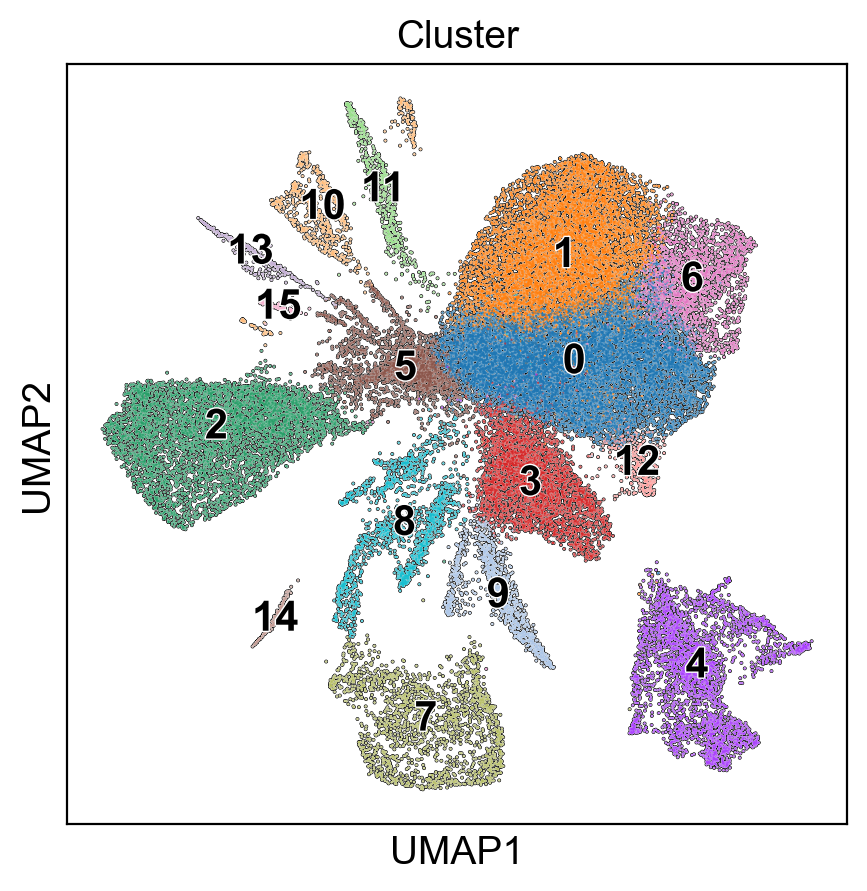

In [3]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(5,5))
'''
sc.pl.umap(adata, color=['ID'],add_outline=True, legend_loc='right margin',
               legend_fontsize=15, legend_fontoutline= 1,frameon= True,save= 'Sample.pdf' )
sc.pl.umap(adata, color=['cluster_0.2'],add_outline=True, legend_loc='right margin',
               legend_fontsize=15, legend_fontoutline= 1,frameon= True,title="Cluster",save= 'cluster.pdf' )
'''
sc.pl.umap(adata, color='cluster_0.5',add_outline=True, legend_loc='on data',
               legend_fontsize=15, legend_fontoutline= 1,frameon= True,title="Cluster")

In [4]:
cluster = {
    'Microglial cell':["Apoe",'Cst3'],
    'Macrophage':["Ms4a7","Cd74"],
    'T cell':["Cd3d"],
    'Vascular endothelial cell':["Pecam1"],
    'Schwann cell':['Cryab'],
    'Fibroblast':["Dcn","Lum"],
    'Neutrophils':["Lcn2","S100a9"],
    'Oligodendrocyte precursor cell':["Tnr","Pdgfra"],
    'Oligodendrocyte':["Plp1"],
    'Ependymal cell':["Tmem212","Foxj1"]
}

In [5]:
markers = ["Apoe","Cst3","Csf1r",#Microglial cell
           "Ms4a7","Cd68",#Macrophage
           "Map2","Stmn2","Meg3",#Neuron
           "Tmem212","Foxj1",#Ependymal cell
           "Plp1","Gfap",#Oligodendrocyte
           "Olig2","Pdgfra",#Oligodendrocyte precursor cell少突胶质前体细胞
           "Cryab",#Schwann cell 雪旺细胞
           "Flt3","Zbtb46",#Dendritic cell树突状细胞
           "Lcn2","S100a9",#Neutrophil
           "Pecam1",#Vascular endothelial cell
           "Cd3d",#T cell
           "Dcn","Lum",#Fibroblast
          ]

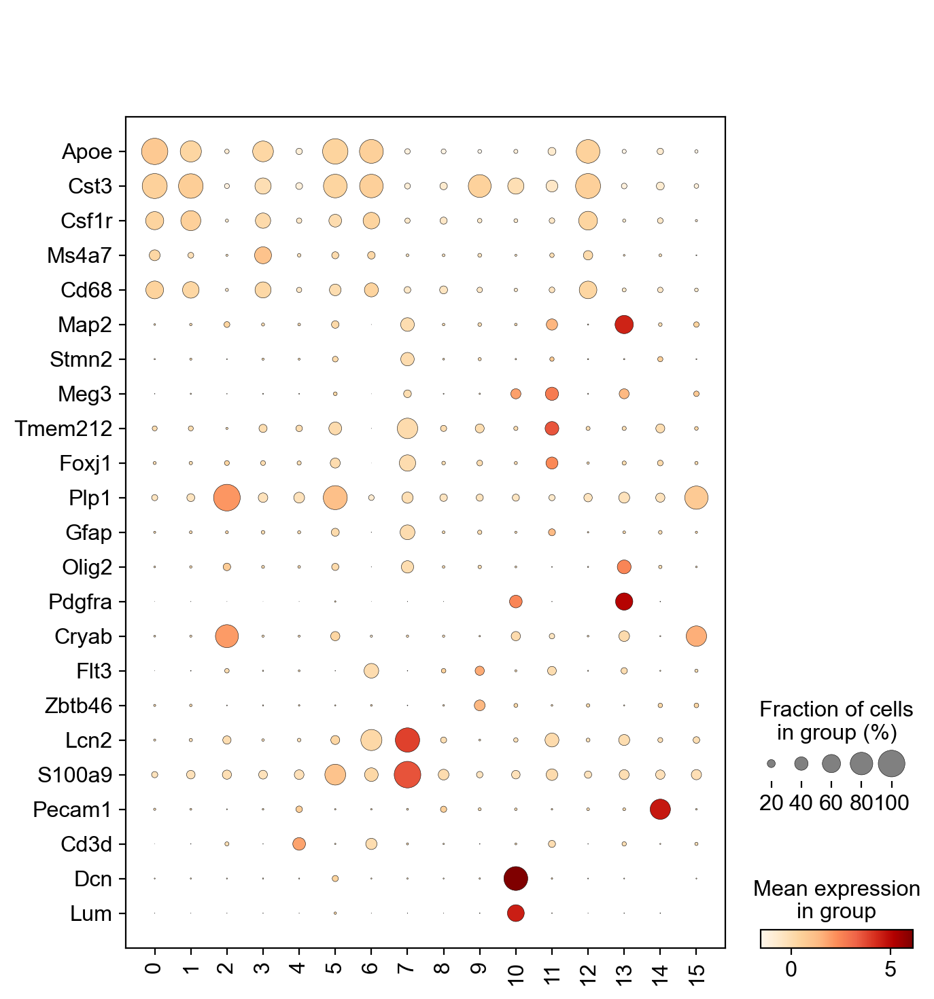

In [6]:
sc.pl.dotplot(adata,markers,'cluster_0.5',cmap='OrRd',swap_axes=True)

In [7]:
def annot_prelim(cluster):
    if cluster in ['0','1','6','12']:
         return('Microglial cell')
    elif cluster in ['5','2']:
        return('Oligodendrocyte')
    elif cluster in ['3','9']:
        return('Macrophages')
    elif cluster =='7':
        return('Neutrophil')
    elif cluster =='14':
        return('Vascular endothelial cell')
    elif cluster =='15':
        return('Schwann cell')
    elif cluster =='13':
        return('Oligodendrocyte precursor cell')
    elif cluster =='11':
        return('Ependymal cell')
    elif cluster =='10':
        return('Fibroblast')
    elif cluster =='4':
        return('T cell')
    else:
        return('Unkown')

In [8]:
adata.obs['Cell type'] = adata.obs['cluster_0.5'].map(annot_prelim)

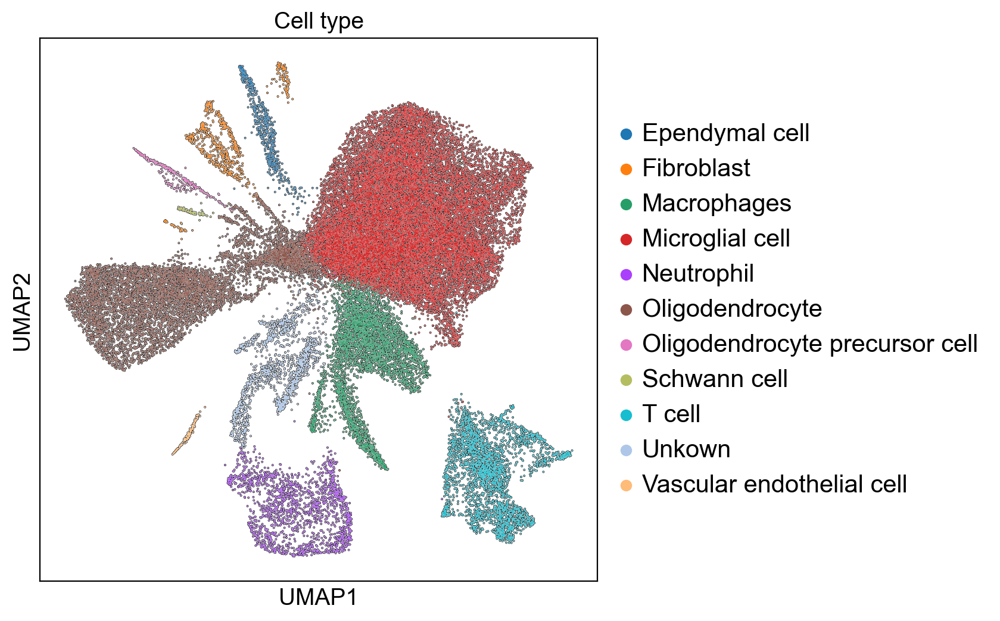

In [9]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(6,6))
sc.pl.umap(adata, color='Cell type',add_outline=True, legend_loc='right margin',
               legend_fontsize=15, legend_fontoutline= 1,frameon= True)

In [10]:
adata.obs["Cell type"] = adata.obs["Cell type"].astype('category')
adata.obs["Cell type"].cat.categories

Index(['Ependymal cell', 'Fibroblast', 'Macrophages', 'Microglial cell',
       'Neutrophil', 'Oligodendrocyte', 'Oligodendrocyte precursor cell',
       'Schwann cell', 'T cell', 'Unkown', 'Vascular endothelial cell'],
      dtype='object')

In [11]:
new_colors = np.empty(len(adata.obs["Cell type"].cat.categories), dtype=object) 
new_colors[[0]] = '#0099CC' # Ependymal cell
new_colors[[1]] = '#339933' # Fibroblast
new_colors[[2]] = '#0066FF' # Macrophages
new_colors[[3]] = '#FF0000' # Microglial cell
new_colors[[4]] = '#FF33FF' # Neutrophil
new_colors[[5]] = '#FF6600' #Oligodendrocyte
new_colors[[6]] = '#FFFF33' # Oligodendrocyte precursor cell
new_colors[[7]] = '#FF1493' # Schwann cell
new_colors[[8]] = '#CC0066' # T cell
new_colors[[9]] = '#483D8B' # Unkown
new_colors[[10]] ='#00FF99' # Vascular endothelial cell
adata.uns["Cell type_colors"] = new_colors
new_colors

array(['#0099CC', '#339933', '#0066FF', '#FF0000', '#FF33FF', '#FF6600',
       '#FFFF33', '#FF1493', '#CC0066', '#483D8B', '#00FF99'],
      dtype=object)

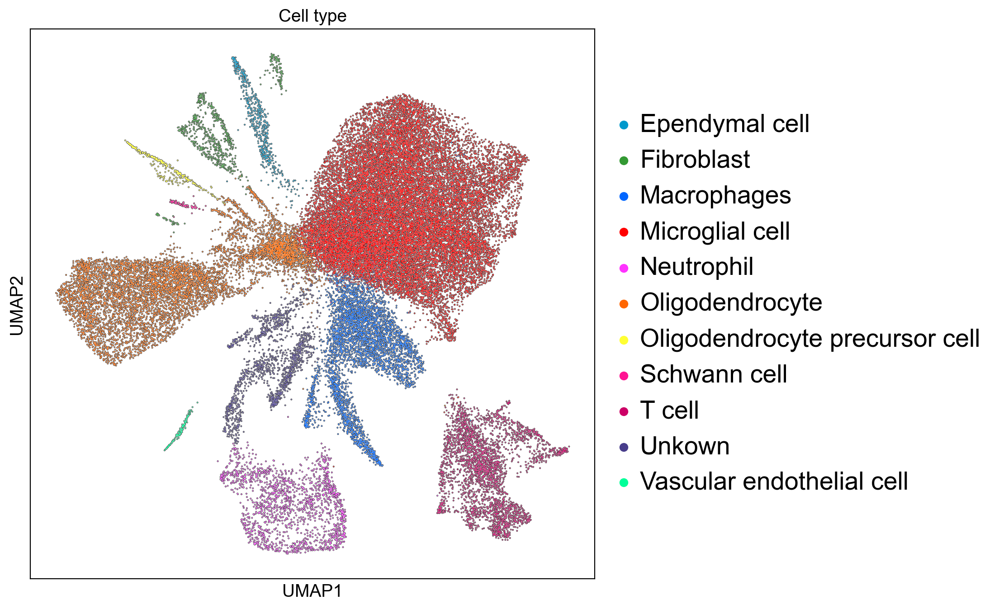

In [12]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(8,8))
sc.pl.umap(adata, color='Cell type',legend_loc='right margin', legend_fontsize=20, legend_fontoutline= 2,add_outline=True,
              frameon= True,save='cell type.pdf')

In [13]:
cluster = {
    'Microglial cell':["Apoe",'Cst3'],
    'Macrophage':["Ms4a7","Cd74"],
    'T cell':["Cd3d"],
    'Vascular endothelial cell':["Pecam1"],
    'Schwann cell':['Cryab'],
    'Fibroblast':["Dcn","Lum"],
    'Neutrophils':["Lcn2","S100a9"],
    'Oligodendrocyte precursor cell':["Tnr","Pdgfra"],
    'Oligodendrocyte':["Plp1"],
    'Ependymal cell':["Tmem212","Foxj1"]
}
marker_list = []

for k,v in cluster.items():
    if isinstance(v,list):
        marker_list.extend(v)
    else:
        marker_list.append(v)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns["dendrogram_['Cell type']"]`
categories: Ependymal cell, Fibroblast, Macrophages, etc.
var_group_labels: Microglial cell, Macrophage, T cell, etc.


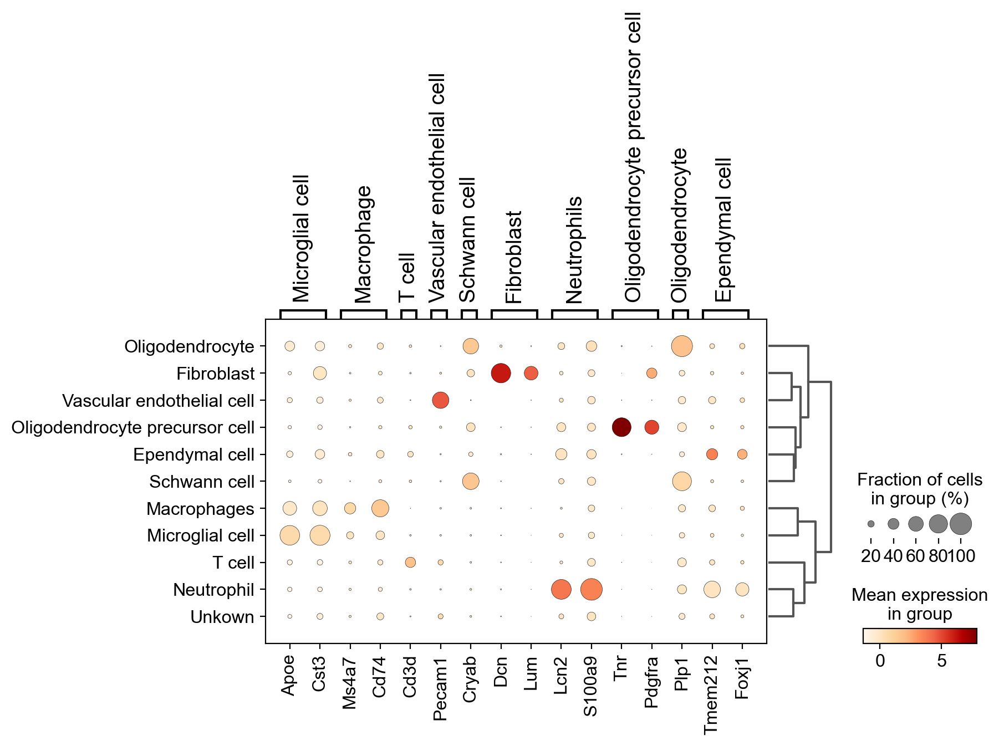

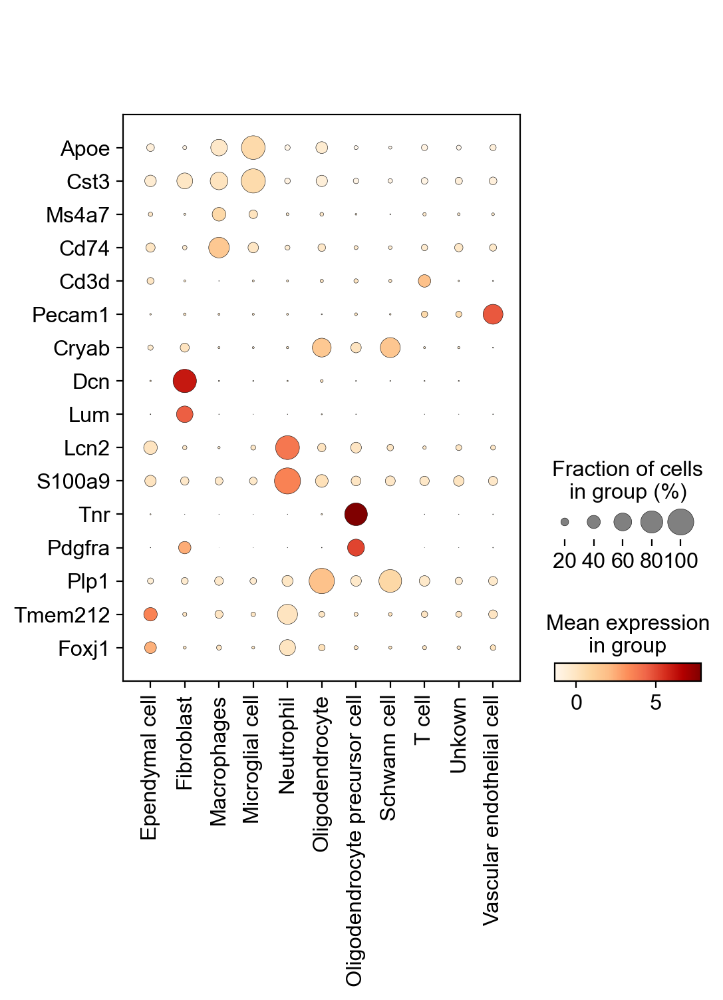

In [14]:
sc.pl.dotplot(adata, cluster, 'Cell type', dendrogram=True,cmap='OrRd',save= 'DOTmarker1.pdf')
sc.pl.dotplot(adata,marker_list, 'Cell type',cmap='OrRd',swap_axes=True,save= 'DOTmarker2.pdf')

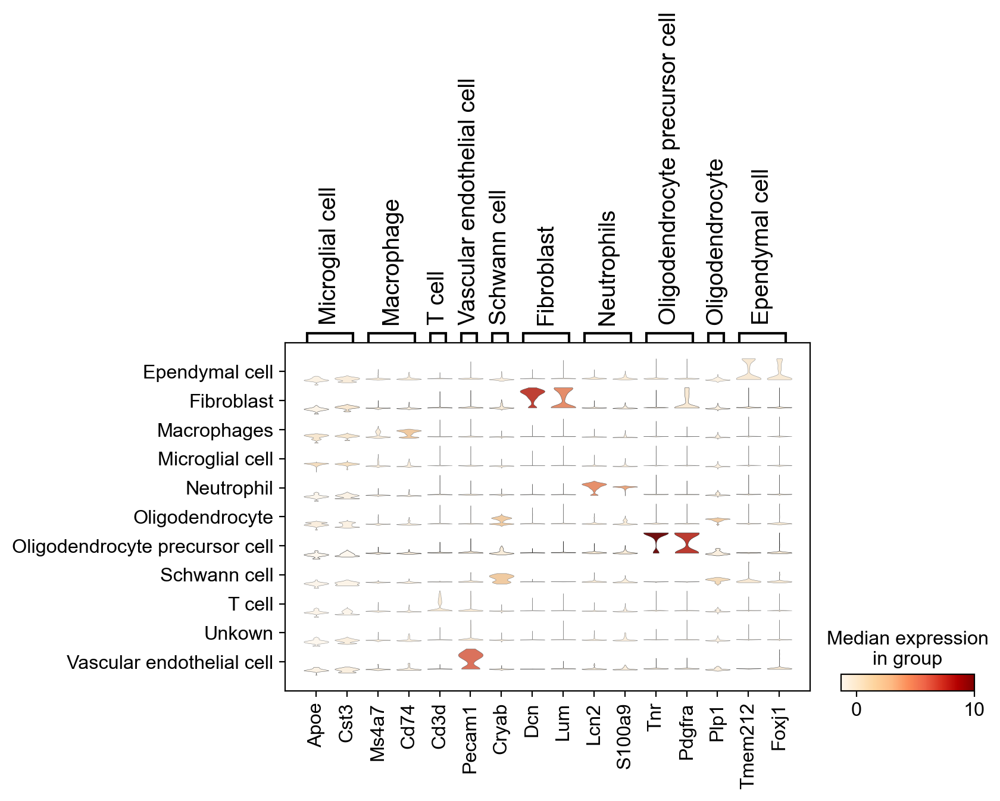

In [15]:
sc.pl.stacked_violin(adata, cluster, 'Cell type', cmap='OrRd',swap_axes=False,save='marker.pdf')

In [16]:
import scanpy as sc
import numpy as np
import pandas as pd
import anndata2ri
anndata2ri.activate()

Unable to determine R home: [WinError 2] 系统找不到指定的文件。
Unable to determine R library path: Command '('D:\\R-4.1.1\\bin\\Rscript', '-e', 'cat(Sys.getenv("LD_LIBRARY_PATH"))')' returned non-zero exit status 1.


In [19]:
%load_ext rpy2.ipython

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [20]:
%%R 
library(future)
library(RColorBrewer)
library(viridis)
library(Seurat)
library(harmony)
library(tidyverse)
library(patchwork)
library(ggplot2)
library(cowplot)
library(dplyr)
library(data.table)

In [51]:
adata.obs

,n_genes,ID,percent_mito,batch,n_counts,log_counts,doublet_scores,predicted_doublets,doublet_info,cluster_0.1,...,cluster_0.7,cluster_0.8,cluster_0.9,cluster_1.0,cluster_1.1,cluster_1.2,cluster_1.3,cluster_1.4,cluster_1.5,Cell type
AAACCCAAGACCGCCT-1,614,220615,0.020630,0,921.0,6.825460,0.049921,False,False,0,...,0,0,1,1,0,0,0,6,0,Microglial cell
AAACCCAAGCAAGTCG-1,1237,220615,0.014971,0,2271.0,7.727975,0.091308,False,False,2,...,10,14,15,14,15,14,15,16,18,Unkown
AAACCCAAGGGAGGTG-1,668,220615,0.008014,0,1123.0,7.023759,0.075294,False,False,0,...,5,5,5,3,4,4,5,4,2,Macrophages
AAACCCAAGGTCACTT-1,1295,220615,0.017918,0,2623.0,7.872074,0.089100,False,False,0,...,7,7,7,7,8,8,7,7,5,Microglial cell
AAACCCAAGTCGCCCA-1,842,220615,0.012138,0,1483.0,7.301822,0.199095,False,False,0,...,0,11,8,9,6,7,6,12,8,Microglial cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTCGCGTTG-1,438,220628,0.029617,2,574.0,6.352629,0.079919,False,False,0,...,0,0,1,1,0,0,0,1,0,Microglial cell
TTTGTTGGTGCCTGAC-1,264,220628,0.026866,2,335.0,5.814131,0.041765,False,False,0,...,0,0,1,1,0,0,0,1,0,Microglial cell
TTTGTTGGTTCAAACC-1,342,220628,0.016432,2,426.0,6.054440,0.074406,False,False,0,...,0,0,1,1,0,0,0,1,0,Microglial cell
TTTGTTGGTTTCGCTC-1,362,220628,0.021956,2,501.0,6.216606,0.108824,False,False,0,...,1,1,0,0,1,1,1,3,4,Microglial cell


In [53]:
UMAP =adata.obsm["X_umap"]
data = pd.DataFrame(UMAP)
data.index = adata.obs.index
data['cell.type'] = adata.obs['Cell type']
data.rename(columns={0:'UMAP_1',1:"UMAP_2"},inplace=True)
data

,UMAP_1,UMAP_2,cell.type
AAACCCAAGACCGCCT-1,8.588531,9.577502,Microglial cell
AAACCCAAGCAAGTCG-1,3.607788,-0.138734,Unkown
AAACCCAAGGGAGGTG-1,7.971753,0.386336,Macrophages
AAACCCAAGGTCACTT-1,10.131894,3.283884,Microglial cell
AAACCCAAGTCGCCCA-1,8.657892,9.198396,Microglial cell
...,...,...,...
TTTGTTGGTCGCGTTG-1,9.468714,8.121394,Microglial cell
TTTGTTGGTGCCTGAC-1,9.298485,6.995629,Microglial cell
TTTGTTGGTTCAAACC-1,7.174190,7.628821,Microglial cell
TTTGTTGGTTTCGCTC-1,8.172114,6.058440,Microglial cell


In [67]:
%%R -i data -o mydata
options(repr.plot.width = 12, repr.plot.height = 8)
mydata = data
allcolour <- c('#0099CC', '#339933', '#0066FF', '#FF0000', '#FF33FF', '#FF6600',
       '#FFFF33', '#FF1493', '#CC0066', '#483D8B', '#00FF99')

p1 = ggplot(mydata,aes(x= UMAP_1 , y = UMAP_2 ,color = cell.type)) +geom_point(size = 1 , alpha =1 )+
    scale_color_manual(values = allcolour)+
    theme(panel.grid.major = element_blank(), #主网格线
          panel.grid.minor = element_blank(), #次网格线 
          panel.border = element_blank(), #边框
          axis.title = element_blank(),  #轴标题
          axis.text = element_blank(), # 文本
          axis.ticks = element_blank(),
          panel.background = element_rect(fill = 'white'), #背景色
          plot.background=element_rect(fill="white"))+
    theme(legend.title = element_blank(), #去掉legend.title 
          legend.key=element_rect(fill='white'), #
          legend.text = element_text(size=20), #设置legend标签的大小
          legend.key.size=unit(1,'cm') ) +  # 设置legend标签之间的大小
    guides(color = guide_legend(override.aes = list(size=3.9)))+ #设置legend中 点的大小 
    geom_segment(aes(x = min(mydata$UMAP_1) , y = min(mydata$UMAP_2) ,
                     xend = min(mydata$UMAP_1) +6.5, yend = min(mydata$UMAP_2) ),
                 colour = "black", size=1,arrow = arrow(length = unit(0.3,"cm")))+ 
    geom_segment(aes(x = min(mydata$UMAP_1)  , y = min(mydata$UMAP_2)  ,
                     xend = min(mydata$UMAP_1) , yend = min(mydata$UMAP_2) + 6.5),
                 colour = "black", size=1,arrow = arrow(length = unit(0.3,"cm"))) +
    annotate("text", x = min(mydata$UMAP_1) +3, y = min(mydata$UMAP_2) -1.5, label = "UMAP_1",
             color="black",size = 3, fontface="bold" ) + 
    annotate("text", x = min(mydata$UMAP_1) -1.5, y = min(mydata$UMAP_2) + 3, label = "UMAP_2",
             color="black",size = 3, fontface="bold" ,angle=90) 
ggsave('./cache/xxxl.jpg',p1,width =12,height = 8,dpi = 1000 )

In [69]:
%%R -i adata -o scRNA
scRAN =adata
scRNA

TypeError: int() argument must be a string, a bytes-like object or a number, not 'NAType'

In [36]:
Sample = adata.obs['ID']
cell_type = adata.obs['Cell type']
A = adata.obs
A

,n_genes,ID,percent_mito,batch,n_counts,log_counts,doublet_scores,predicted_doublets,doublet_info,cluster_0.1,...,cluster_0.7,cluster_0.8,cluster_0.9,cluster_1.0,cluster_1.1,cluster_1.2,cluster_1.3,cluster_1.4,cluster_1.5,Cell type
AAACCCAAGACCGCCT-1,614,220615,0.020630,0,921.0,6.825460,0.049921,False,False,0,...,0,0,1,1,0,0,0,6,0,Microglial cell
AAACCCAAGCAAGTCG-1,1237,220615,0.014971,0,2271.0,7.727975,0.091308,False,False,2,...,10,14,15,14,15,14,15,16,18,Unkown
AAACCCAAGGGAGGTG-1,668,220615,0.008014,0,1123.0,7.023759,0.075294,False,False,0,...,5,5,5,3,4,4,5,4,2,Macrophages
AAACCCAAGGTCACTT-1,1295,220615,0.017918,0,2623.0,7.872074,0.089100,False,False,0,...,7,7,7,7,8,8,7,7,5,Microglial cell
AAACCCAAGTCGCCCA-1,842,220615,0.012138,0,1483.0,7.301822,0.199095,False,False,0,...,0,11,8,9,6,7,6,12,8,Microglial cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTCGCGTTG-1,438,220628,0.029617,2,574.0,6.352629,0.079919,False,False,0,...,0,0,1,1,0,0,0,1,0,Microglial cell
TTTGTTGGTGCCTGAC-1,264,220628,0.026866,2,335.0,5.814131,0.041765,False,False,0,...,0,0,1,1,0,0,0,1,0,Microglial cell
TTTGTTGGTTCAAACC-1,342,220628,0.016432,2,426.0,6.054440,0.074406,False,False,0,...,0,0,1,1,0,0,0,1,0,Microglial cell
TTTGTTGGTTTCGCTC-1,362,220628,0.021956,2,501.0,6.216606,0.108824,False,False,0,...,1,1,0,0,1,1,1,3,4,Microglial cell


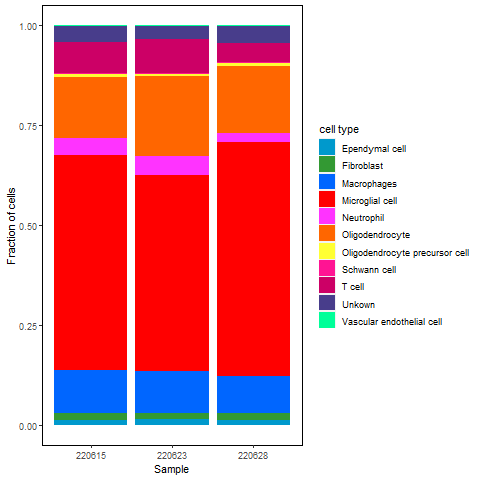

In [81]:
%%R -i A  -o rt
rt <- A
match_celltype_levels <- c('Ependymal cell', 'Fibroblast', 'Macrophages', 'Microglial cell',
       'Neutrophil', 'Oligodendrocyte', 'Oligodendrocyte precursor cell',
       'Schwann cell', 'T cell', 'Unkown', 'Vascular endothelial cell')
allcolour <- c('#0099CC', '#339933', '#0066FF', '#FF0000', '#FF33FF', '#FF6600',
       '#FFFF33', '#FF1493', '#CC0066', '#483D8B', '#00FF99')
a <- rt
length(colnames(a))
colnames(a)[25] = c('cell.type')
a[1:10,]
mydata <- a%>%
  group_by(ID) %>%
  mutate(celltype = factor(cell.type,levels = match_celltype_levels)) %>%
  arrange(celltype)
p1 = ggplot() +
  geom_bar(data = mydata, aes(x = ID, fill = factor(celltype)), position = position_fill(reverse = TRUE)) +scale_fill_manual(values = allcolour) +
  labs(fill = "cell type",x ='Sample', y = "Fraction of cells")+theme(
      panel.grid.major = element_blank(), #主网格线
      panel.grid.minor = element_blank(),
      panel.background = element_rect(fill = 'white'), #背景色
      panel.border = element_rect(fill=NA,color="black", size=0.5, linetype="solid")
        )
p1 


In [ ]:
 theme(panel.grid.major = element_blank(), #主网格线
        panel.grid.minor = element_blank(), #次网格线 
        panel.border = element_blank(), #边框
        #axis.title = element_blank(),  #轴标题
        #axis.text = element_blank(), # 文本
        axis.ticks = element_blank(),
        panel.background = element_rect(fill = 'white'), #背景色
        plot.background=element_rect(fill="white"))
gsave('./figures/Ratios_barplot.pdf',P,width = 18,height = 8,dpi = 1000)

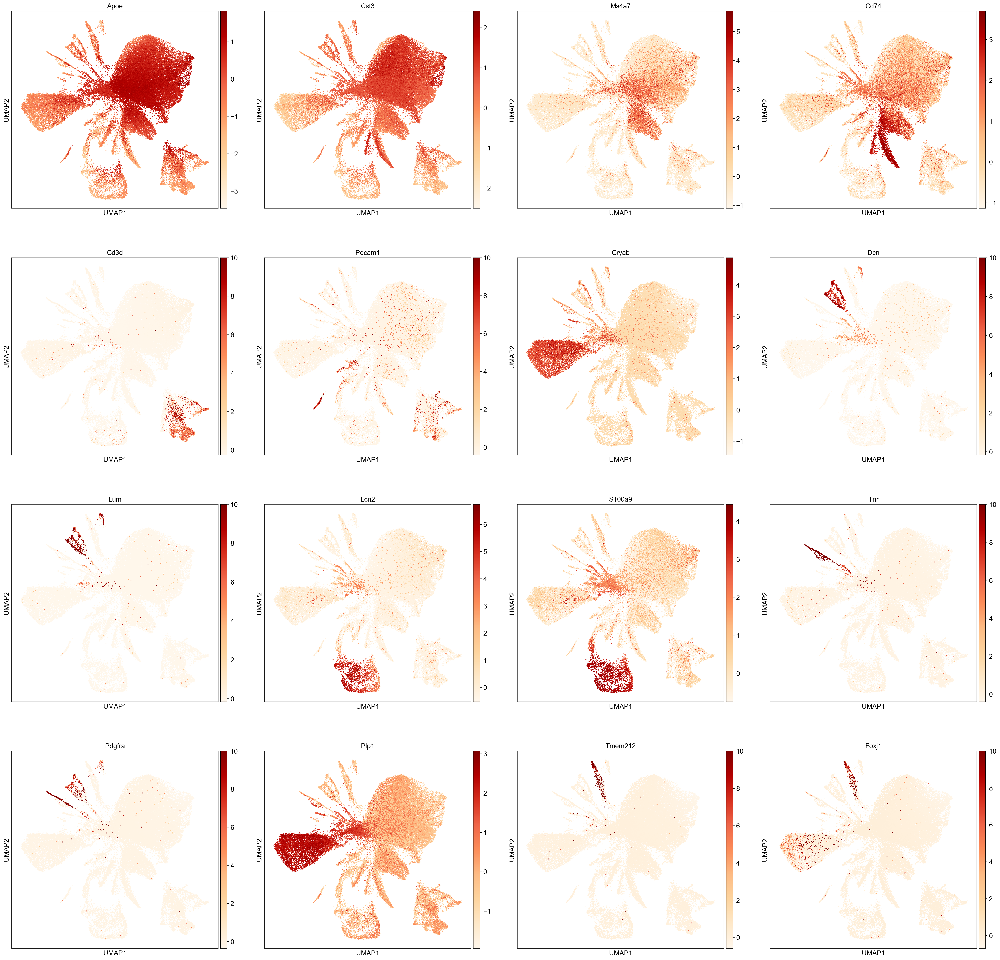

In [75]:
sc.pl.umap(adata,color=marker_list,ncols=4,cmap='OrRd',size=15,legend_fontsize=12,save='allmarker.pdf')

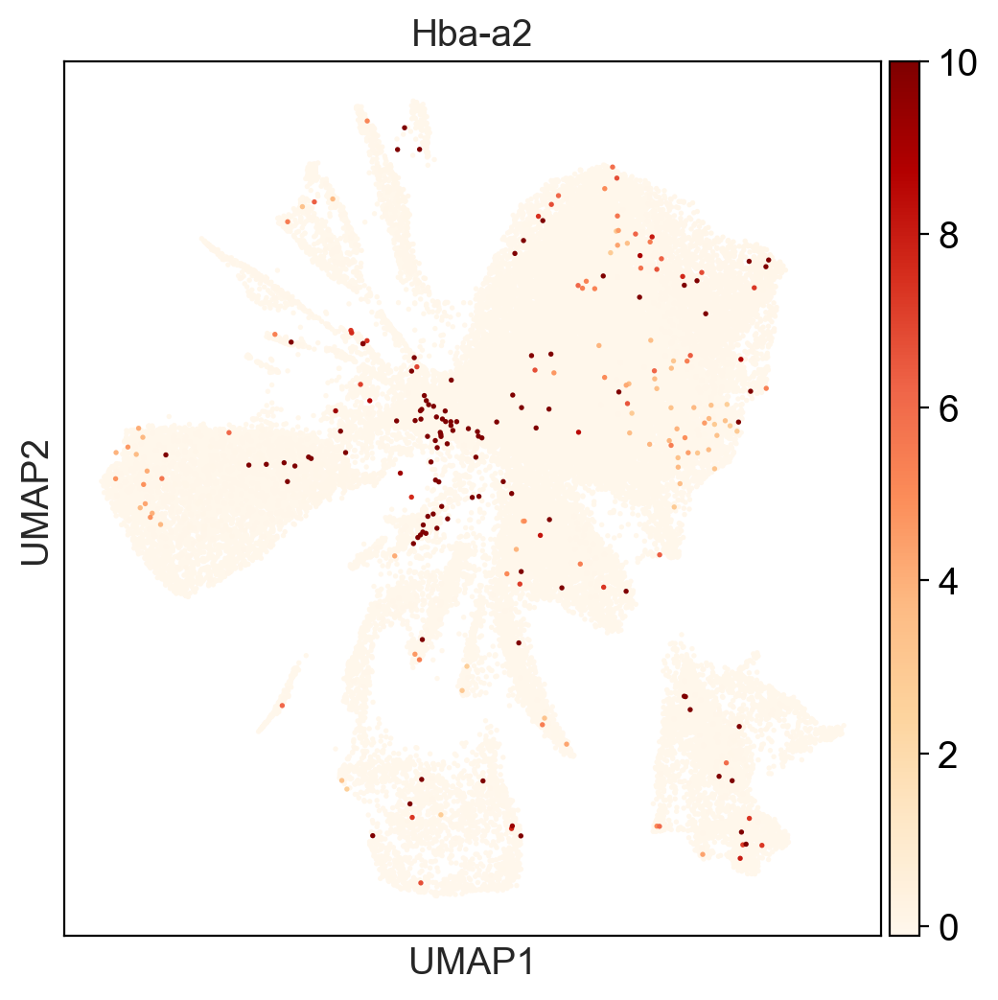

In [91]:
sc.pl.umap(adata,color=["Hba-a2"],ncols=4,cmap='OrRd',size=15,legend_fontsize=12)

In [4]:
adata = sc.read_h5ad('./cache/scRNA_celltype.h5ad')

In [75]:
def draw_population_ratio(df:pd.DataFrame, x:str, y:str,
                          * ,data_colors:dict=None,
                          normalize=True,
                          path=None,
                          legend=True,
                          figsize=(8, 20)):
    df = df[[x, y]]
    x_items = df[x].cat.categories.tolist()
    y_items = df[y].cat.categories.tolist()
    y_dict = df[y].value_counts().to_dict()
    
    heights = []
    for x_item in x_items:
        tmp_result = []
        x_item_counter = df[df[x]==x_item][y].value_counts().to_dict()
        for y_item in y_items:
            tmp_result.append(x_item_counter.get(y_item, 0))
        heights.append(tmp_result)
    heights = np.asarray(heights)
    if normalize:
        heights = heights/np.sum(heights, axis=0)
    heights = (heights.T/np.sum(heights, axis=1)).T
    plt.figure(figsize=figsize)
    _last = np.matrix([0.]* heights.shape[0])
    for i, y_item in enumerate(y_items):
        p = plt.bar(range(0, heights.shape[0]), heights[:, i],
                    bottom=np.asarray(_last)[0],
                    color=data_colors.get(y_item, 'b'),
                    label=y_item
                   )
        _last = _last + np.matrix(heights[:, i])
    plt.xticks(range(0, len(x_items)),labels=x_items, rotation=90)
    plt.ylim((0, 1))
    if legend:
        plt.legend()
        ax = plt.gca()
        ax.legend(bbox_to_anchor=(0.5, 0, 0.7, 1))
    if path is not None:
        plt.savefig(path, dpi=600)

In [79]:
adata.obs['Cell type'].value_counts()

Microglial cell                   24093
Oligodendrocyte                    7984
Macrophages                        4712
T cell                             3314
Neutrophil                         1816
Unkown                             1691
Fibroblast                          754
Ependymal cell                      639
Oligodendrocyte precursor cell      335
Vascular endothelial cell           141
Schwann cell                         83
Name: Cell type, dtype: int64

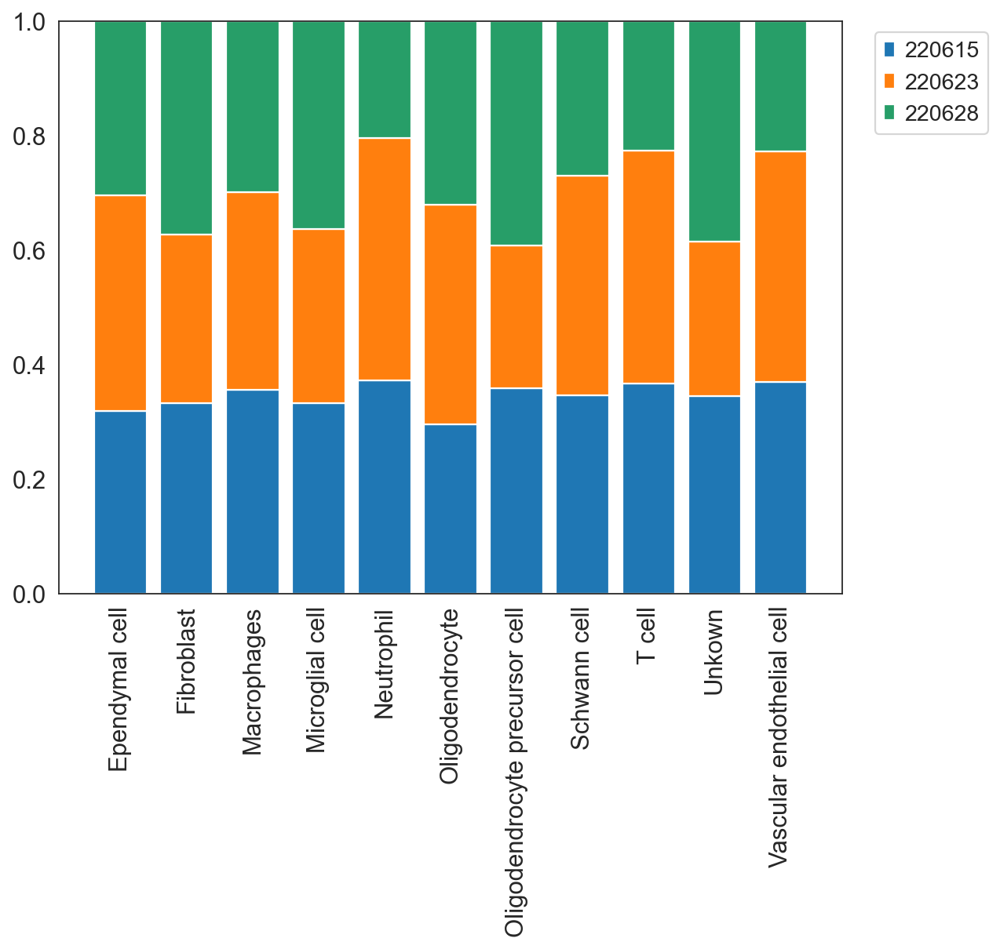

In [76]:
sns.set_style('white')
fig = draw_population_ratio(adata.obs, x='Cell type', y='ID',path='./figures/barplot.pdf',figsize=(8,6),
                      data_colors=dict(zip(adata.obs.ID.cat.categories, adata.uns['ID_colors'])),
                     )

In [84]:
adata.write('./cache/scRNA_celltype.h5ad')

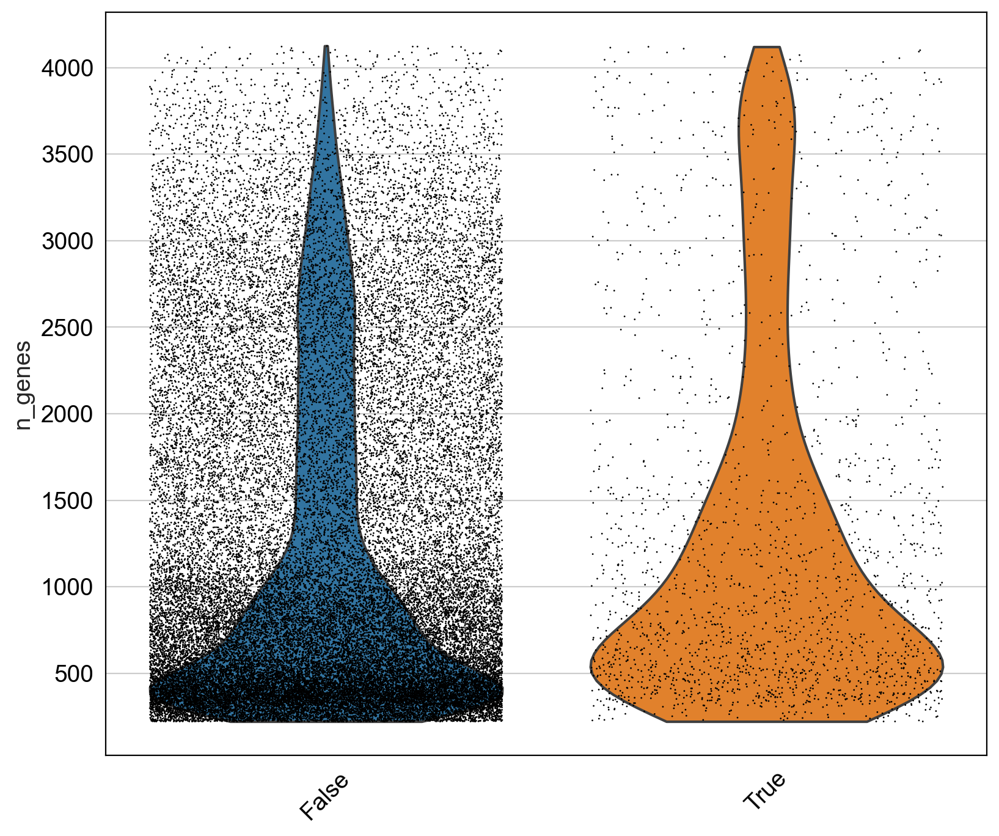

In [78]:
sc.settings.set_figure_params(dpi=100,dpi_save=600,figsize=(8,8))
sc.pl.violin(adata, 'n_genes',
             jitter=0.4, groupby = 'doublet_info', rotation=45,save='doublet_delete.pdf')

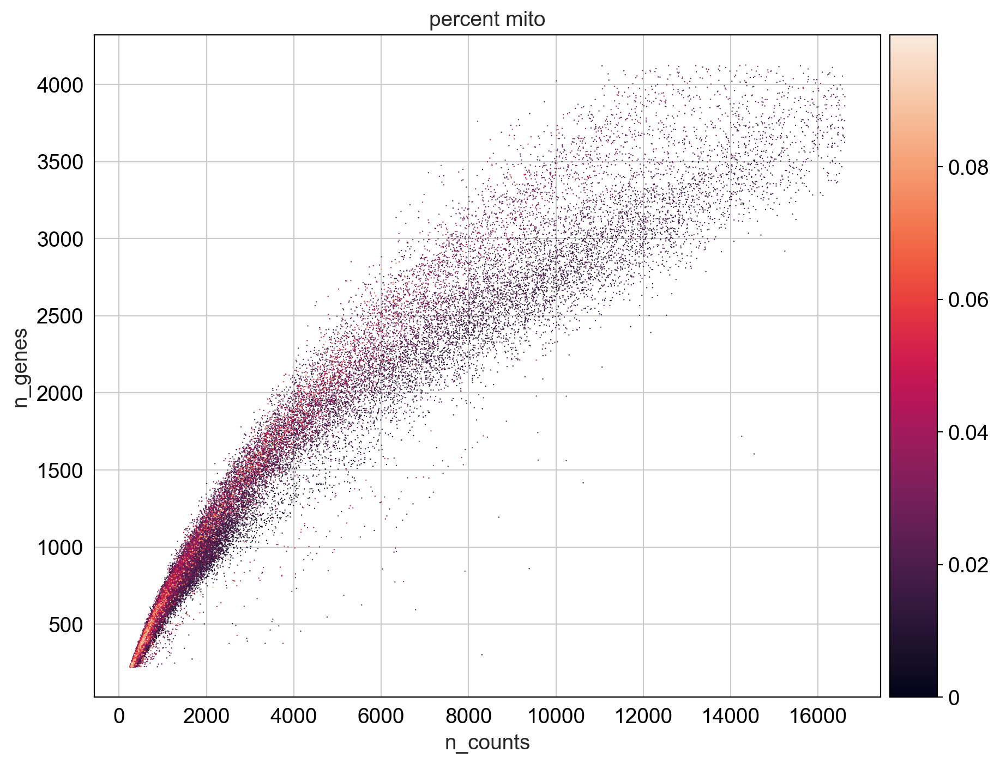

In [79]:
p1 = sc.pl.scatter(adata, 'n_counts', 'n_genes', color='percent_mito',save='percent.pdf')

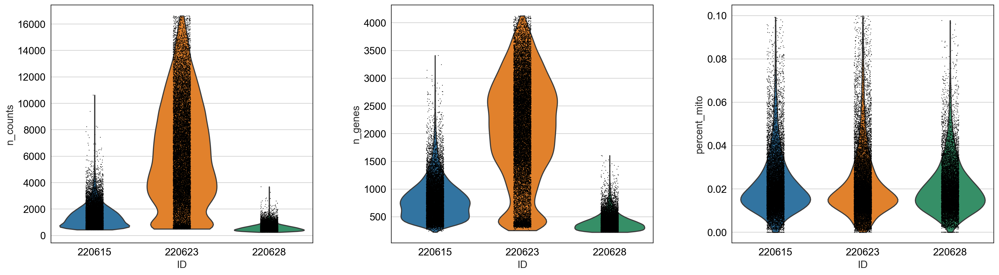

In [80]:
plt.rcParams['figure.figsize']=(6,6)
t3 = sc.pl.violin(adata, ['n_counts','n_genes','percent_mito'], groupby='ID',save='qc_after.pdf')